In [1]:
from sktime.datasets import load_UCR_UEA_dataset
import numpy as np
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sktime.transformations.compose import FitInTransform
from sktime.transformations.series.adapt import TabularToSeriesAdaptor
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sktime.transformations.panel.compose import ColumnTransformer
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

In [2]:
t_s_euclidean=np.load('time_series_distanza_euclidea_100.npy')
ts_paa_vect=np.load('X_finale_normalizzato_100.npy')
y_sampled=np.load('generi_100.npy')
ids_sampled=np.load('ids_100.npy')

In [3]:
ts_paa_vect.shape

(2000, 1, 160)

In [4]:
shapelets=np.load('shapelets.npy', allow_pickle=True)

In [5]:
shapelets.shape

(150,)

In [6]:
shapelets

array([array([[-0.48546717],
              [-0.78681558],
              [-0.90867555],
              [-0.92236853],
              [-0.96481019],
              [-0.89861369],
              [-0.8560394 ],
              [-0.80247754],
              [-0.69367492],
              [-0.55907726],
              [-0.36890364],
              [-0.1904617 ],
              [ 0.05126095],
              [ 0.25330985],
              [ 0.42462289],
              [ 0.64333034],
              [ 0.74701273],
              [ 0.82627088],
              [ 0.89905262],
              [ 0.92314804]]), array([[ 0.9455018 ],
                                      [ 0.95930785],
                                      [-0.07999281],
                                      [-0.36257538],
                                      [ 0.96885008],
                                      [ 0.97703469],
                                      [ 0.81781566],
                                      [-0.51848334],
                         

## prova genere 2

In [120]:
class_2_indices=np.where(y_train==2)[0]
x_train_class_2=X_train[class_2_indices]
df_22=pd.DataFrame(x_train_class_2)
df_22['label']='prova2'

In [121]:
df_22

,0,1,2,3,4,5,6,7,8,9,...,151,152,153,154,155,156,157,158,159,label
0,-0.240654,-0.490684,-0.680302,-0.738872,-0.812625,-0.711246,-0.599659,-0.616236,-0.529852,-0.403127,...,0.073192,0.022720,0.056347,0.172925,0.230186,0.241477,0.184990,0.092355,0.053006,prova2
1,-1.312088,-0.848916,-0.410969,-0.146426,-0.044232,0.045987,0.073955,0.159687,0.279641,0.460343,...,0.252457,0.274012,0.244015,0.169323,0.103973,0.111717,0.135044,0.032217,0.068529,prova2
2,-0.792410,0.171181,0.488160,0.534022,0.323614,0.214941,0.146610,0.321272,0.373207,0.468099,...,0.564676,0.657667,0.654571,0.568595,0.518895,0.459316,0.382086,0.298548,0.197390,prova2
3,1.051806,1.721402,1.545123,1.380567,1.000365,0.831817,0.797413,0.778093,0.795129,0.793671,...,-1.119918,-1.085771,-0.872946,-0.729764,-0.610729,-0.472387,-0.310000,-0.124902,0.009867,prova2
4,0.413563,-0.087346,-0.284984,-0.549080,-0.477506,-0.320792,-0.328536,-0.380620,-0.389856,-0.360424,...,-0.148717,-0.135671,-0.147395,-0.169466,-0.178345,-0.164166,-0.161070,-0.199366,-0.200722,prova2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75,0.014213,0.553359,0.306374,-0.115953,-0.229231,-0.262194,-0.125423,-0.061468,-0.048035,-0.184272,...,0.163420,0.210941,0.171796,0.122108,0.104138,0.077838,0.045420,0.024121,-0.000226,prova2
76,-1.274426,-0.400854,-0.446779,-0.742167,-0.682721,-0.566418,-0.331827,-0.123095,-0.069042,-0.090561,...,-0.226561,-0.202506,-0.258471,-0.398469,-0.530003,-0.583358,-0.517215,-0.512337,-0.582846,prova2
77,1.283411,2.713870,1.810127,1.410075,1.198454,0.936847,0.772870,0.659318,0.796774,0.923142,...,-0.183452,-0.182826,-0.187887,-0.182820,-0.176663,-0.184888,-0.206262,-0.228587,-0.224549,prova2
78,0.686946,0.915887,1.200500,1.335983,1.079129,0.770815,0.485975,0.414812,0.294054,0.214147,...,-0.140899,-0.155736,-0.155195,-0.093971,-0.082826,-0.049707,-0.021760,0.005421,0.014115,prova2


In [124]:
mean_vectors_2=np.mean(x_train_class_2, axis=1)

In [125]:
mean_vectors_2.shape

(80,)

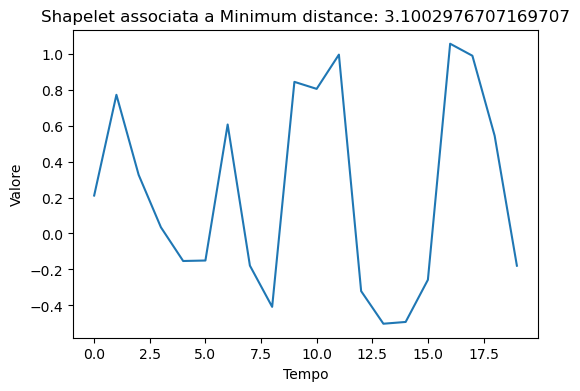

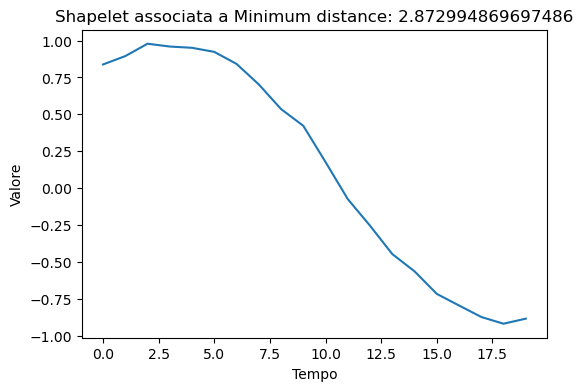

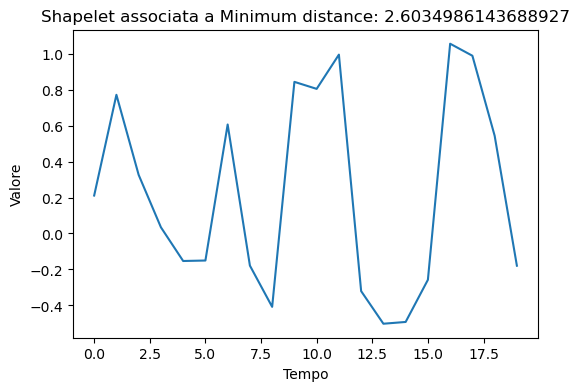

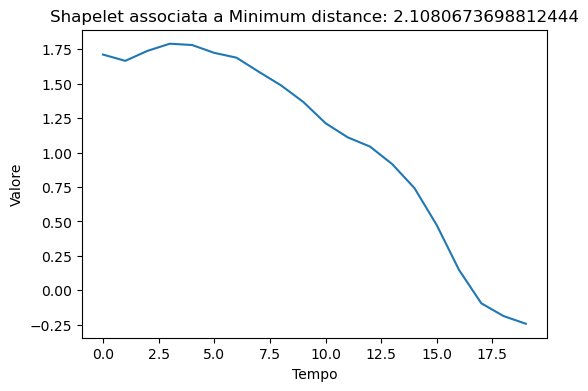

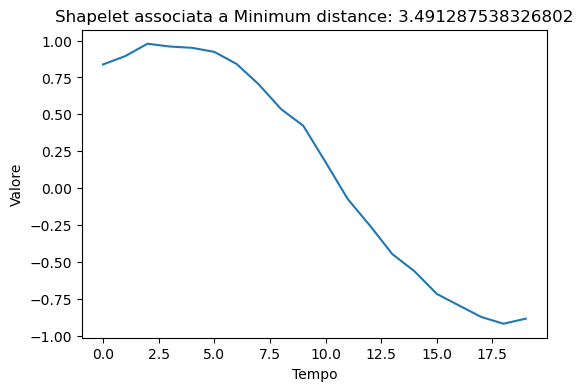

...

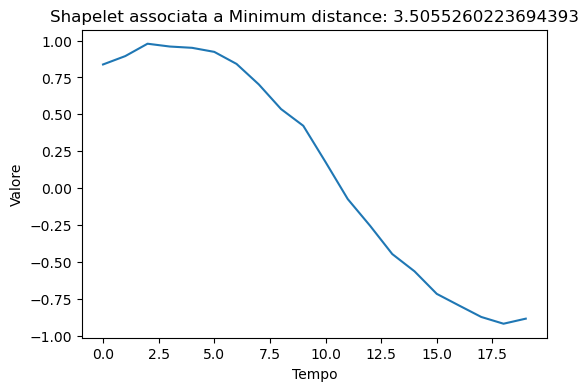

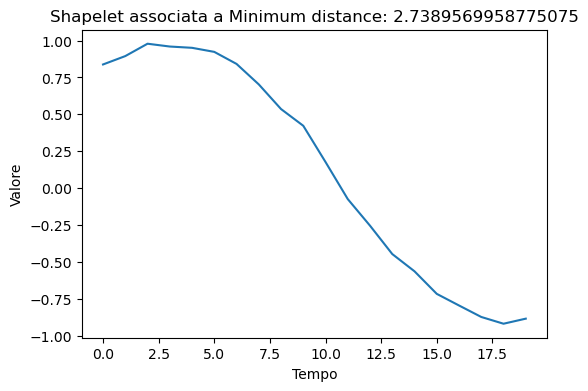

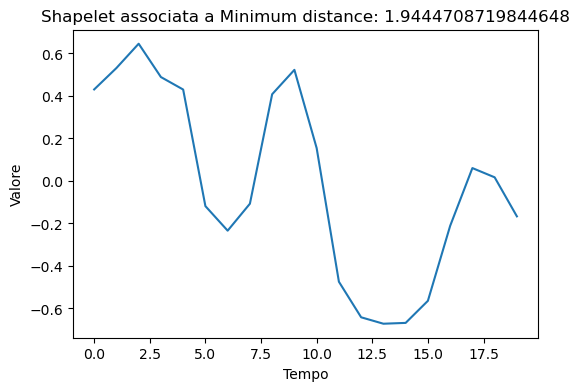

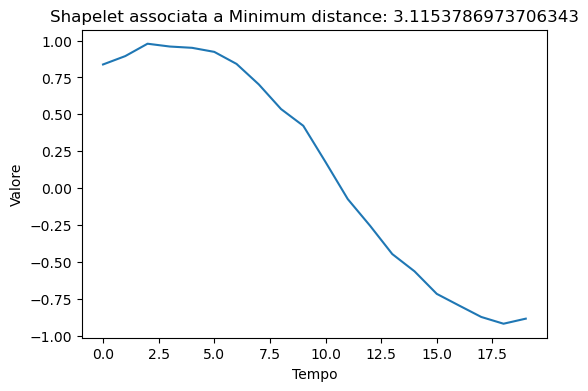

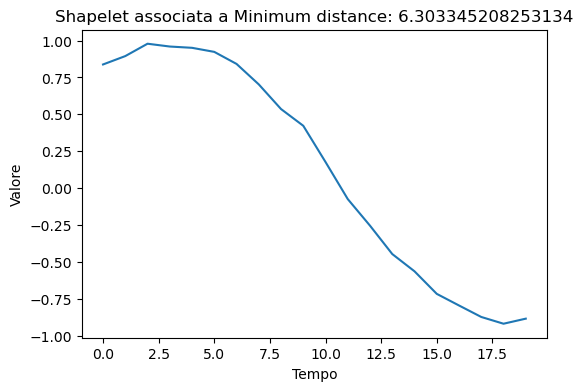

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Inizializza un array per salvare le distanze euclidee minime
min_distances = []

# Inizializza un array per salvare gli indici delle shapelets associate alle distanze minime
closest_indices = []

# Calcola la distanza euclidea per ciascuna shapelet
for shaplet in shapelets:
    # Inizializza un array per salvare le distanze euclidee per ogni genere
    genre_distances = []
    
    # Calcola la distanza euclidea tra la shapelet e ciascuna media delle time series del genere
    for mean_vector in mean_vectors_2:
        distance = np.linalg.norm(shaplet - mean_vector)
        genre_distances.append(distance)
    
    # Trova la distanza minima e l'indice associato
    min_distance = min(genre_distances)
    min_index = genre_distances.index(min_distance)
    
    # Aggiungi la distanza minima e l'indice associato agli array
    min_distances.append(min_distance)
    closest_indices.append(min_index)

# Converte gli array in NumPy array
min_distances = np.array(min_distances)
closest_indices = np.array(closest_indices)

# Visualizza le shapelets associate alle distanze minime
for i, index in enumerate(closest_indices):
    plt.figure(figsize=(6, 4))
    plt.plot(shapelets[index])
    plt.title(f'Shapelet associata a Minimum distance: {min_distances[i]}')
    plt.xlabel('Tempo')
    plt.ylabel('Valore')
    plt.show()


# prova 19

In [127]:
class_19_indices=np.where(y_train==19)[0]
x_train_class_19=X_train[class_19_indices]
df_19=pd.DataFrame(x_train_class_19)
df_19['label']='minimal-techno'

In [128]:
df_19

,0,1,2,3,4,5,6,7,8,9,...,151,152,153,154,155,156,157,158,159,label
0,-1.448037,-0.171670,0.717955,0.308065,0.094482,-0.194937,-0.430358,-0.564680,-0.494598,-0.507540,...,-0.100531,-0.096383,-0.086428,-0.121183,-0.148647,-0.134774,-0.162830,-0.208448,-0.143061,minimal-techno
1,-0.318456,-0.304027,-0.188177,-0.214241,0.242289,0.351266,0.394238,0.279177,0.202383,0.102409,...,0.251912,0.260654,0.239494,0.216341,0.176371,0.193803,0.205648,0.163622,0.086628,minimal-techno
2,-0.099835,-0.391387,-0.327210,-0.071654,0.100480,0.090251,0.069068,0.012572,-0.005108,-0.049454,...,-0.026189,-0.020479,-0.017878,-0.018773,-0.023195,-0.036271,-0.055219,-0.073015,-0.100937,minimal-techno
3,-0.900880,-0.688888,-0.317529,-0.279666,-0.364186,-0.304335,-0.261531,-0.188033,-0.218388,-0.306051,...,0.826915,0.870695,0.807583,0.787698,0.703004,0.672690,0.715038,0.644955,0.572588,minimal-techno
4,-0.368300,-0.566747,-0.760714,-0.854041,-0.831733,-0.764322,-0.722118,-0.697830,-0.662259,-0.578370,...,0.075655,0.083318,0.075383,0.031057,-0.044592,-0.155789,-0.155532,-0.016585,0.095658,minimal-techno
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75,-0.558067,-0.718510,-0.816538,-0.577003,-0.520877,-0.571272,-0.640256,-0.559431,-0.435604,-0.444938,...,0.216210,0.199493,0.185947,0.123557,0.106435,0.125285,0.138216,0.140083,0.125447,minimal-techno
76,0.725337,1.267437,1.274161,1.045180,0.770183,0.533976,0.466601,0.371996,0.276197,0.203180,...,0.054800,0.130211,0.157837,0.143693,0.141193,0.053617,0.026943,0.027361,0.047653,minimal-techno
77,-1.167877,-0.909800,-0.752381,-0.558513,-0.526965,-0.495259,-0.594569,-0.571610,-0.587086,-0.612199,...,-0.100058,0.032599,0.001570,-0.074757,-0.053311,0.026633,0.111520,0.118181,0.159485,minimal-techno
78,0.529150,0.060218,-0.166693,-0.267214,-0.183529,-0.179008,-0.133356,-0.104311,-0.113044,-0.132214,...,0.243166,0.261823,0.322825,0.306627,0.233771,0.183537,0.228031,0.320867,0.310490,minimal-techno


In [131]:
mean_vectors_19=np.mean(x_train_class_19, axis=1)

In [132]:
mean_vectors_19.shape

(80,)

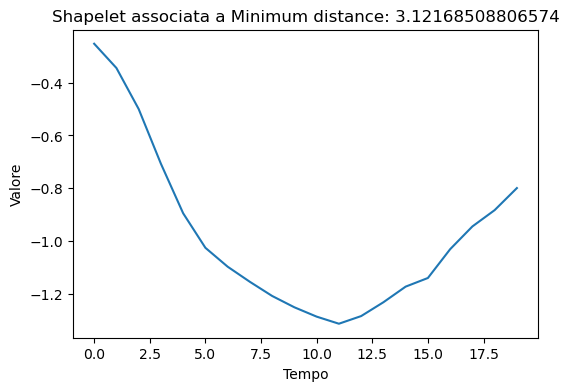

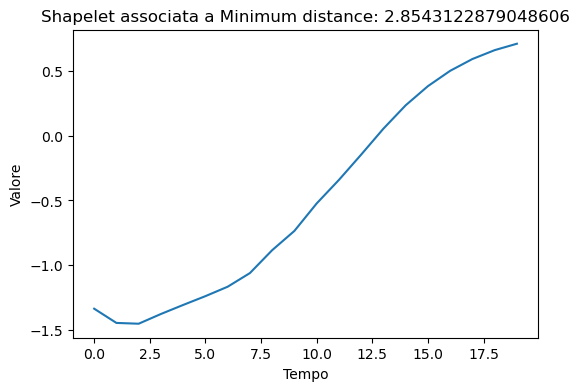

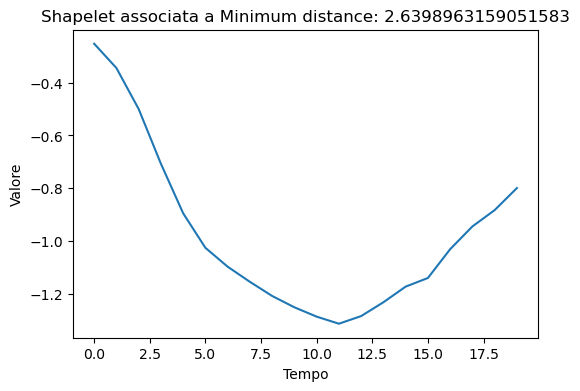

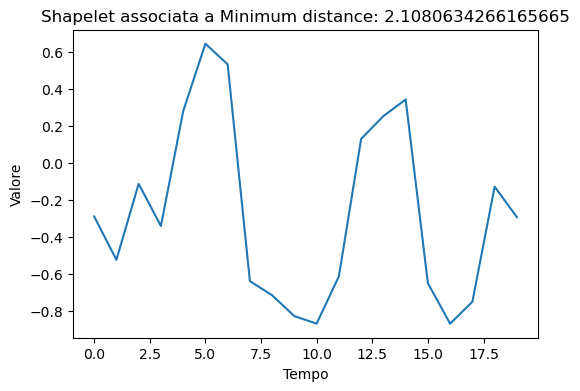

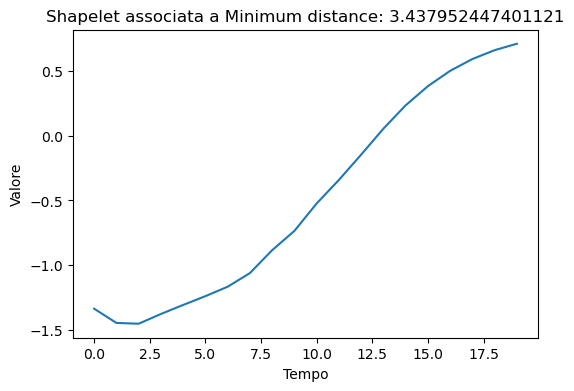

...

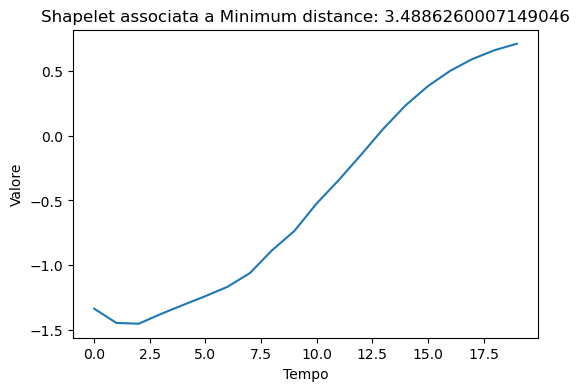

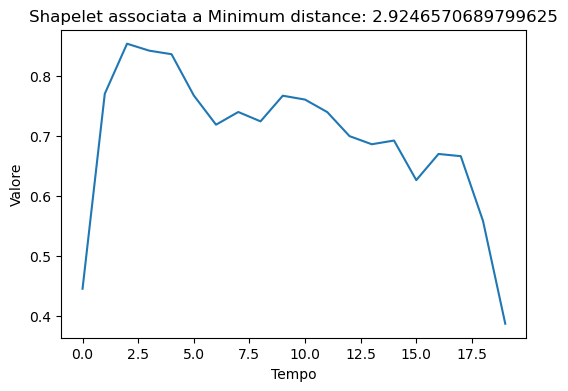

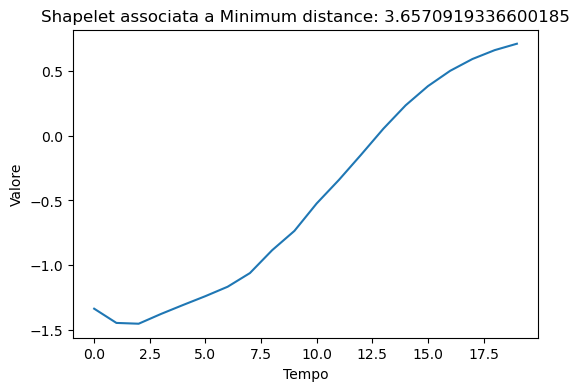

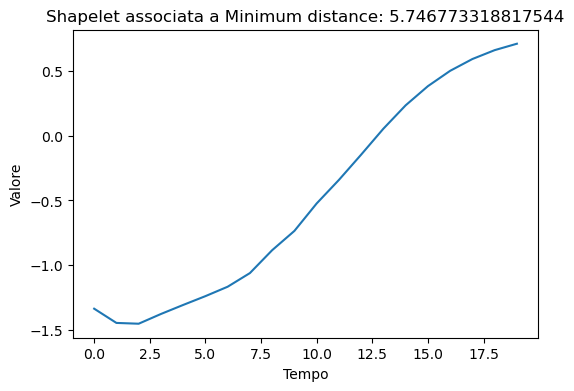

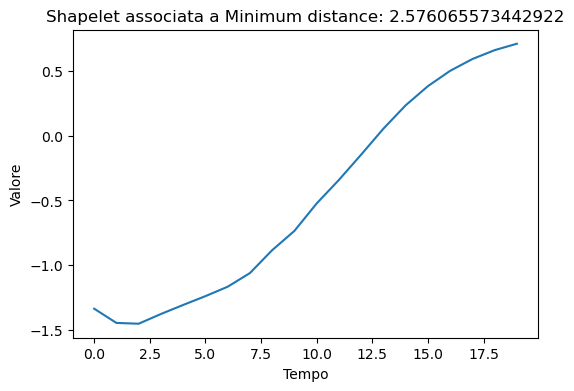

In [133]:
import numpy as np
import matplotlib.pyplot as plt

# Inizializza un array per salvare le distanze euclidee minime
min_distances = []

# Inizializza un array per salvare gli indici delle shapelets associate alle distanze minime
closest_indices = []

# Calcola la distanza euclidea per ciascuna shapelet
for shaplet in shapelets:
    # Inizializza un array per salvare le distanze euclidee per ogni genere
    genre_distances = []
    
    # Calcola la distanza euclidea tra la shapelet e ciascuna media delle time series del genere
    for mean_vector in mean_vectors_19:
        distance = np.linalg.norm(shaplet - mean_vector)
        genre_distances.append(distance)
    
    # Trova la distanza minima e l'indice associato
    min_distance = min(genre_distances)
    min_index = genre_distances.index(min_distance)
    
    # Aggiungi la distanza minima e l'indice associato agli array
    min_distances.append(min_distance)
    closest_indices.append(min_index)

# Converte gli array in NumPy array
min_distances = np.array(min_distances)
closest_indices = np.array(closest_indices)

# Visualizza le shapelets associate alle distanze minime
for i, index in enumerate(closest_indices):
    plt.figure(figsize=(6, 4))
    plt.plot(shapelets[index])
    plt.title(f'Shapelet associata a Minimum distance: {min_distances[i]}')
    plt.xlabel('Tempo')
    plt.ylabel('Valore')
    plt.show()


## prova per genere 16

In [134]:
class_16_indices=np.where(y_train==16)[0]
x_train_class_16=X_train[class_16_indices]
df_16=pd.DataFrame(x_train_class_16)
df_16['label']='sleep'

In [135]:
mean_vectors_16=np.mean(x_train_class_16, axis=1)

In [136]:
print(mean_vectors_16.shape)


(80,)


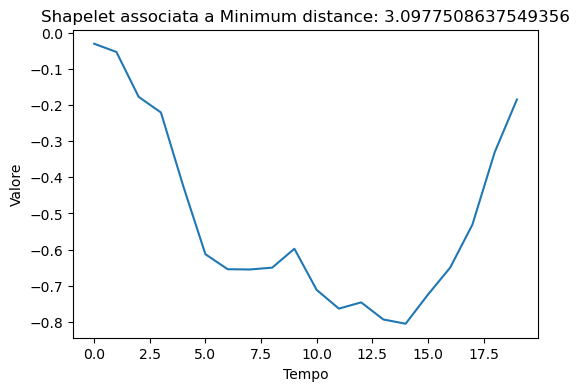

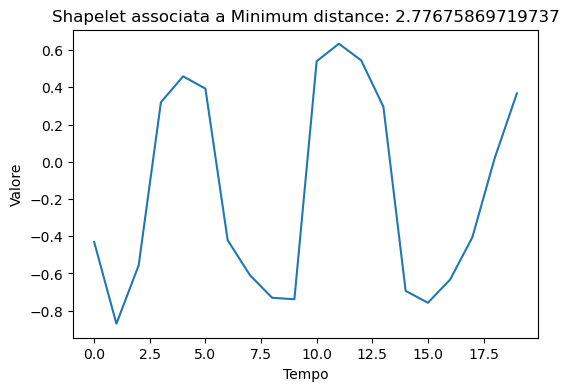

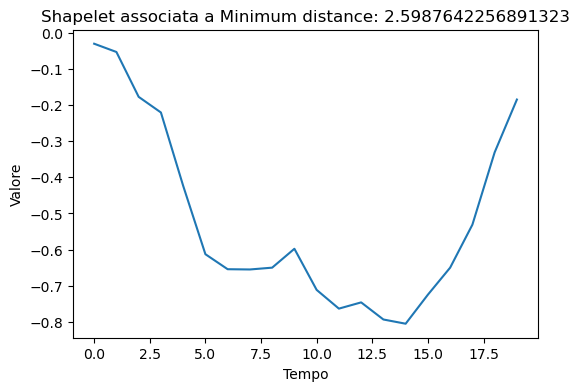

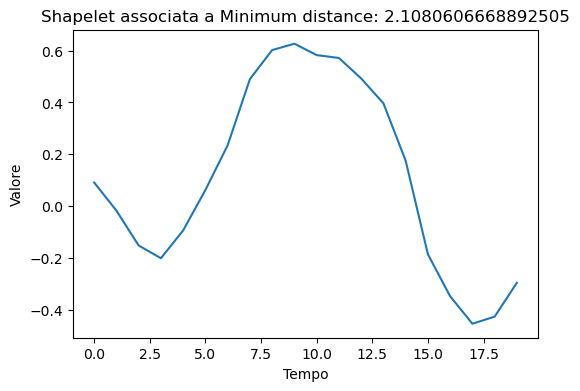

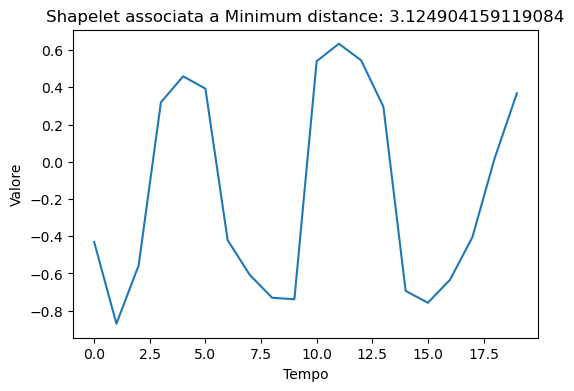

...

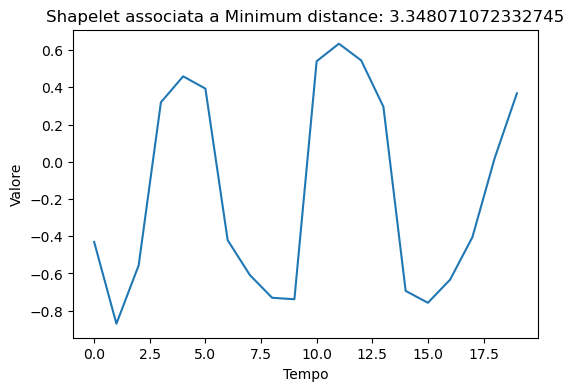

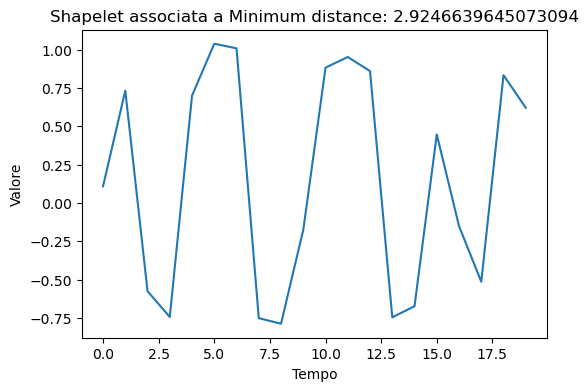

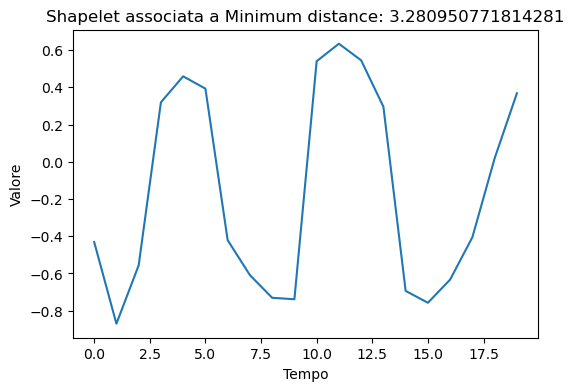

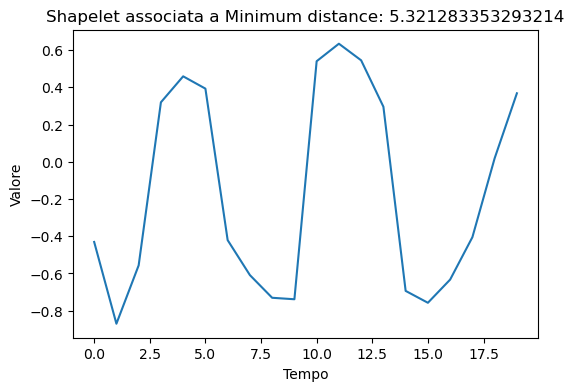

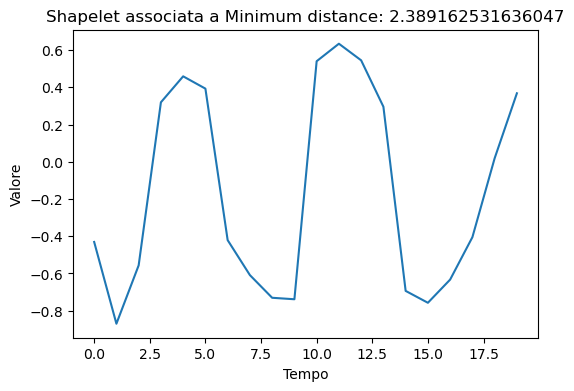

In [137]:
import numpy as np
import matplotlib.pyplot as plt

# Inizializza un array per salvare le distanze euclidee minime
min_distances = []

# Inizializza un array per salvare gli indici delle shapelets associate alle distanze minime
closest_indices = []

# Calcola la distanza euclidea per ciascuna shapelet
for shaplet in shapelets:
    # Inizializza un array per salvare le distanze euclidee per ogni genere
    genre_distances = []
    
    # Calcola la distanza euclidea tra la shapelet e ciascuna media delle time series del genere
    for mean_vector in mean_vectors_16:
        distance = np.linalg.norm(shaplet - mean_vector)
        genre_distances.append(distance)
    
    # Trova la distanza minima e l'indice associato
    min_distance = min(genre_distances)
    min_index = genre_distances.index(min_distance)
    
    # Aggiungi la distanza minima e l'indice associato agli array
    min_distances.append(min_distance)
    closest_indices.append(min_index)

# Converte gli array in NumPy array
min_distances = np.array(min_distances)
closest_indices = np.array(closest_indices)

# Visualizza le shapelets associate alle distanze minime
for i, index in enumerate(closest_indices):
    plt.figure(figsize=(6, 4))
    plt.plot(shapelets[index])
    plt.title(f'Shapelet associata a Minimum distance: {min_distances[i]}')
    plt.xlabel('Tempo')
    plt.ylabel('Valore')
    plt.show()


## Genere 5

In [138]:
class_1_indices=np.where(y_train==1)[0]
x_train_class_1=X_train[class_1_indices]
df_1=pd.DataFrame(x_train_class_1)
df_1['label']='prova'

In [141]:
mean_vectors_1=np.mean(x_train_class_1, axis=1)

In [142]:
mean_vectors_1.shape

(80,)

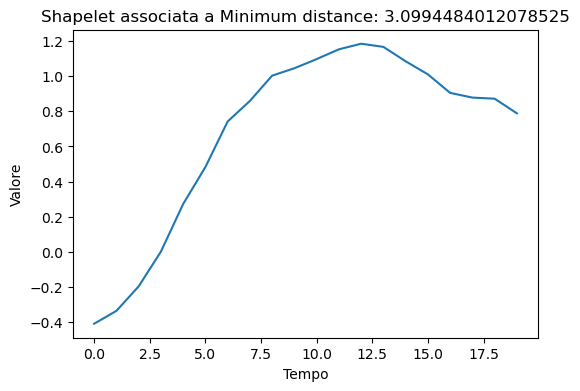

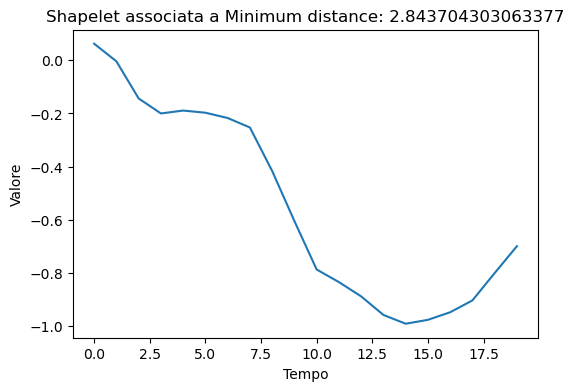

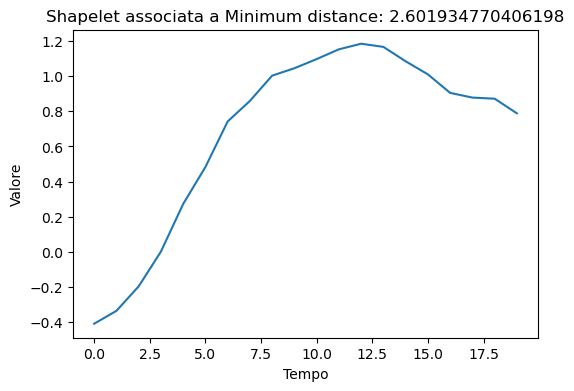

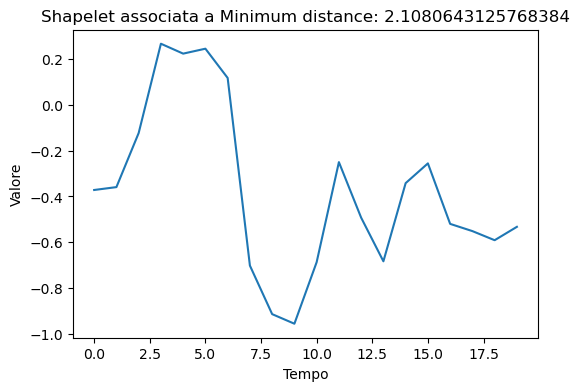

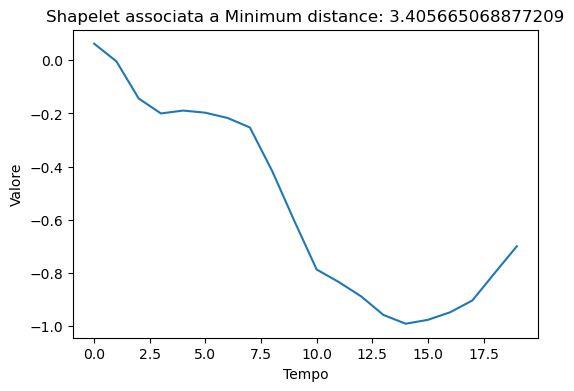

...

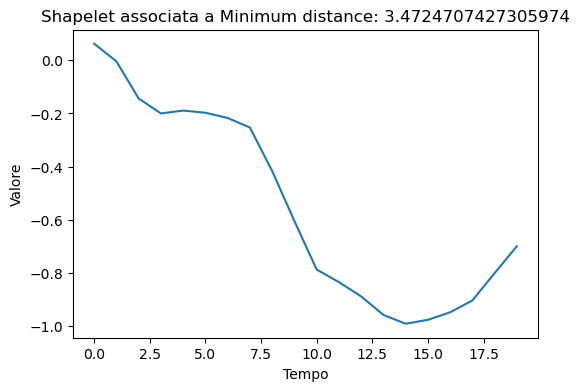

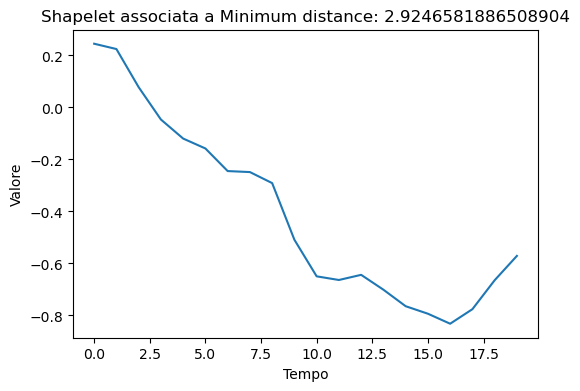

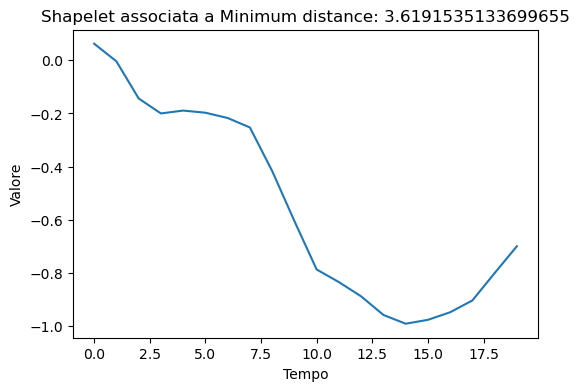

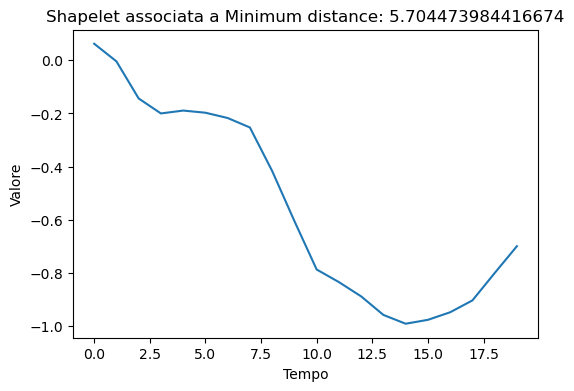

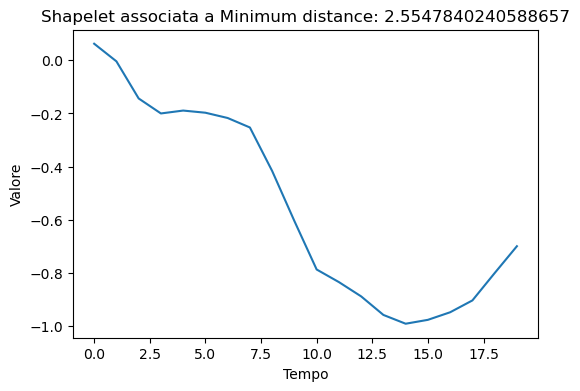

In [143]:
import numpy as np
import matplotlib.pyplot as plt

# Inizializza un array per salvare le distanze euclidee minime
min_distances = []

# Inizializza un array per salvare gli indici delle shapelets associate alle distanze minime
closest_indices = []

# Calcola la distanza euclidea per ciascuna shapelet
for shaplet in shapelets:
    # Inizializza un array per salvare le distanze euclidee per ogni genere
    genre_distances = []
    
    # Calcola la distanza euclidea tra la shapelet e ciascuna media delle time series del genere
    for mean_vector in mean_vectors_1:
        distance = np.linalg.norm(shaplet - mean_vector)
        genre_distances.append(distance)
    
    # Trova la distanza minima e l'indice associato
    min_distance = min(genre_distances)
    min_index = genre_distances.index(min_distance)
    
    # Aggiungi la distanza minima e l'indice associato agli array
    min_distances.append(min_distance)
    closest_indices.append(min_index)

# Converte gli array in NumPy array
min_distances = np.array(min_distances)
closest_indices = np.array(closest_indices)

# Visualizza le shapelets associate alle distanze minime
for i, index in enumerate(closest_indices):
    plt.figure(figsize=(6, 4))
    plt.plot(shapelets[index])
    plt.title(f'Shapelet associata a Minimum distance: {min_distances[i]}')
    plt.xlabel('Tempo')
    plt.ylabel('Valore')
    plt.show()


## Visualizzazione shapltes generiche 

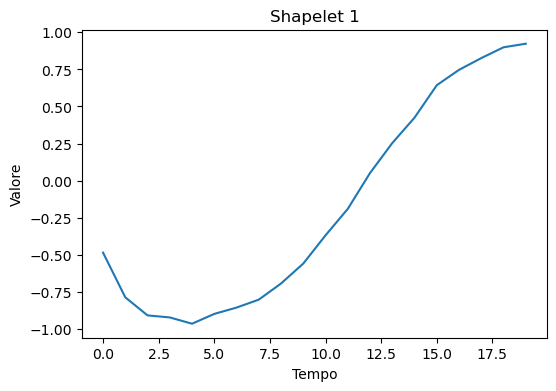

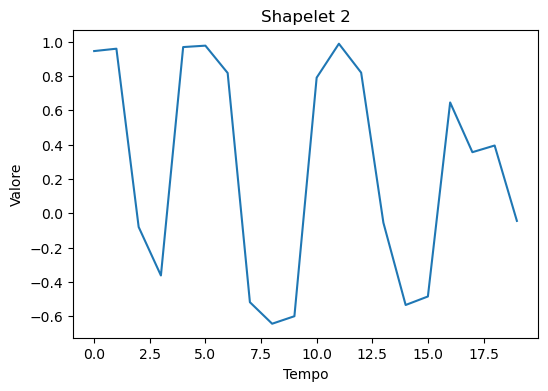

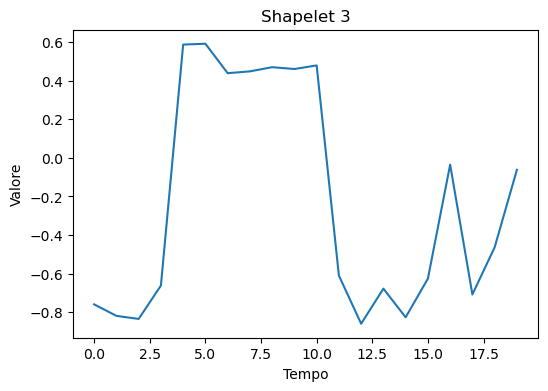

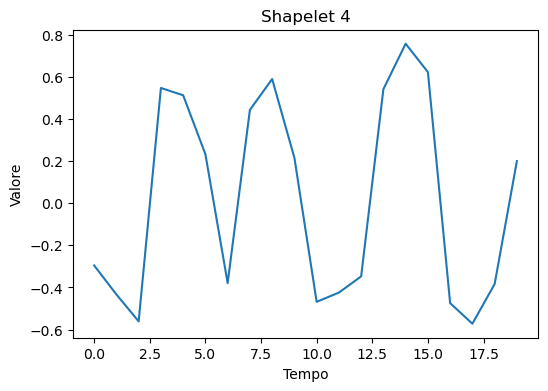

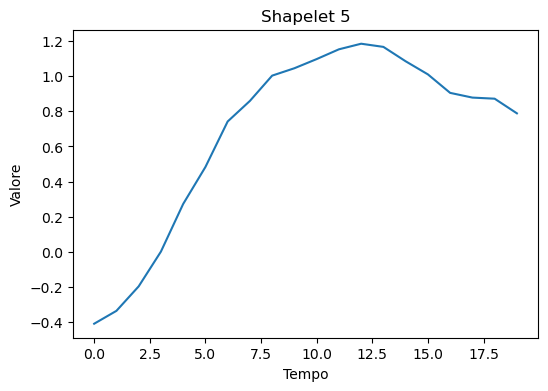

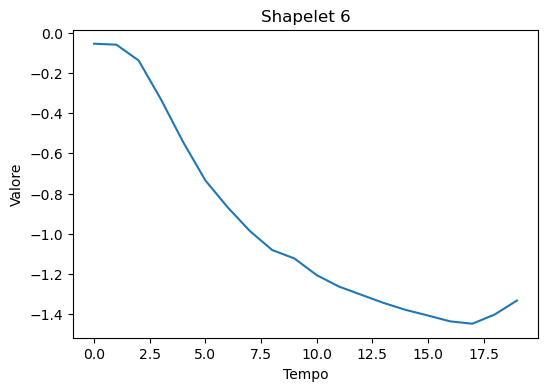

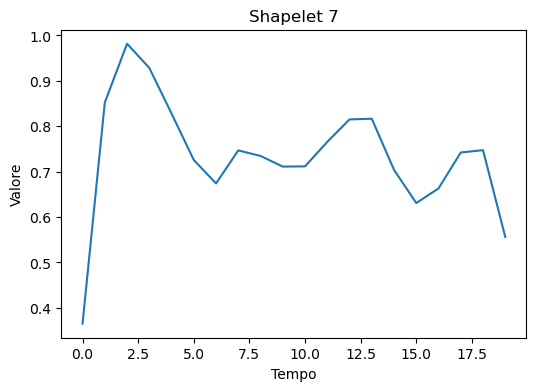

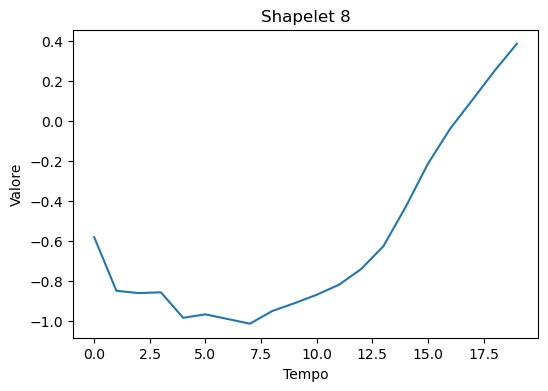

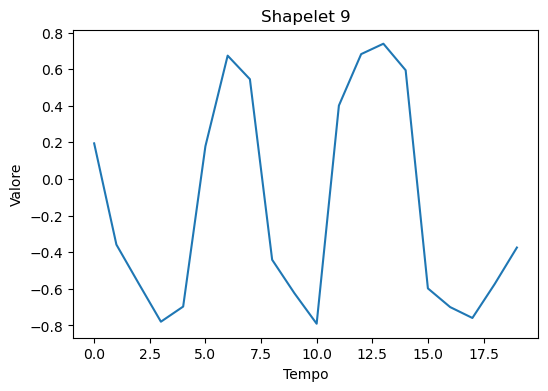

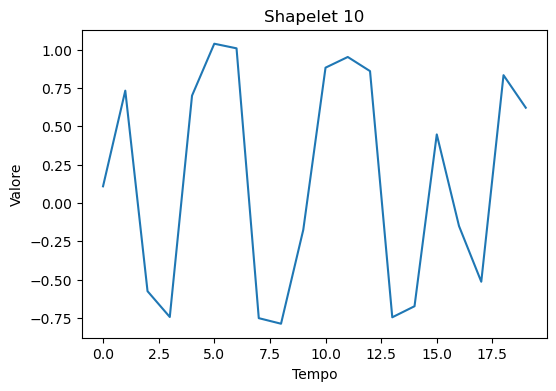

In [144]:
import matplotlib.pyplot as plt

# Visualizza tutte le shapelets
for i, shaplet in enumerate(shapelets[:10]):
    plt.figure(figsize=(6, 4))
    plt.plot(shaplet)
    plt.title(f'Shapelet {i+1}')
    plt.xlabel('Tempo')
    plt.ylabel('Valore')
    plt.show()
